In [2]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import os
from PIL import Image

In [6]:
# Konstante koje se odnose na dimenzije slika koje koristimo i na broj klasa u problemu
ROWS = 64
COLS = 64
NUM_OF_CHANNELS = 3
NUM_OF_CLASSES = 62
# string gde je i-ti karakter oznaka i-te klase
classes = '0123456789abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ'

In [7]:
# Ova funkcija transformiše sliku sa jednim kanalom oblika (n, m, 1) u rgb sliku oblika (n, m, 3)
def from_grayscale_to_rgb(image):
    return np.stack((image,) * 3, axis=-1)

In [10]:
classes[0]

'0'

In [11]:
# X oznacava naše slike
X = []
# y sadrži odgovarajuće oznake klasa naših slika
y = []

# Pošto je skup podataka podeljen Na tri dela koja imaju različito organizovane direktorijume
# ovde su navedene sve putanje do direktorijuma u kojima se nalaze slike
file_paths = ['English\Img\GoodImg\Bmp', 'English\Img\BadImag\Bmp', 'English\Hnd\Img', 'English\Fnt']

# otvaramo pojedinacno svaki direktorijum
for path in file_paths:
    # Svi primeri neke klase se nalaze u direktorijumu Sample0X gde je X broj od 1 do 62
    # Tako se na primer sve slike karaktera 'c' nalaze u direktorijumu Sample013.
    
    # Prolazimo kroz sve klase
    for i in range(1, NUM_OF_CLASSES+1):
        # Ako je klasa jednocifren broj onda je oblika Sample00X inace je oblika Sample0XY
        if i < 10:
            directory_name = path + '\Sample00' + str(i) + '\\'
        else:
            directory_name = path + '\Sample0' + str(i) + '\\'

        # Ispis za lakšu preglednost prolaženja kroz fajlove
        print(directory_name)

        # Otvaramo fajlove u zadatom direktorijumu
        files = os.listdir(directory_name)
        for file in files:
            full_file_name = directory_name + file
            
            # Koristimo Image.open() paketa pillow da bismo otvorili sliku
            img = Image.open(full_file_name)
            print(f'OLD_SHAPE: {img.size}')
            # Koristimo resize() metod jer želimo da nam sve slike imaju iste dimenzije
            img_resized = img.resize((ROWS, COLS))
            
            np_img = None
            
            # Pokušamo da pretvorimo sliku u oblik (ROWS, COLS, NUM_OF_CHANNELS)
            # ako to nije uspešno onda pretvaramo sliku u rgb format pa onda radimo 
            # isto. U međuvremenu pretvaramo sliku u numpy niz.
            try:
                np_img = np.reshape(np.asarray(img_resized), (ROWS, COLS, NUM_OF_CHANNELS))
                print(f'NEW_SHAPE: {np_img.shape}')
            except:
                print(f'GRAYSCALE IMAGE SHAPE: {img.size}')
                print(f'GRAYSCALE IMAGE: {np.asarray(img)}')
                img_rgb = from_grayscale_to_rgb(np.asarray(img_resized))
                np_img = np.reshape(img_rgb, (ROWS, COLS, NUM_OF_CHANNELS))
                print(f'CONVERTED TO RGB: {full_file_name}')
                
            # na kraju dodajemo sliku i njenu brojčanu oznaku klase u skup podataka
            X.append(np_img)
            y.append(i-1)

English\Img\GoodImg\Bmp\Sample001\
OLD_SHAPE: (103, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 122)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (310, 471)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 127)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 104)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample004\
OLD_SHAPE: (85, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 182)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 47)
NEW_SHAPE: (64

OLD_SHAPE: (29, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 47)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample008\
OLD_SHAPE: (142, 155)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 132)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (90, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (

OLD_SHAPE: (114, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (84, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (77, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (112, 197)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 186)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 220)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (93, 131)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (221, 202)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (148, 211)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 9

OLD_SHAPE: (236, 202)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (313, 410)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (318, 417)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (158, 236)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 248)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (175, 165)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (141, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (119, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 92)
NEW_SHAPE: (64, 64

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (106, 161)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (117, 141)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (114, 154)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (100, 193)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (94, 126)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (170, 249)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 6

OLD_SHAPE: (55, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 293)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (158, 319)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (171, 330)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 59)
NEW_SHAPE: (64, 64, 3)
OLD_

OLD_SHAPE: (52, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 191)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (113, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 113)
NEW_SHAPE: (64, 64, 3)
OL

OLD_SHAPE: (53, 95)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample016\
OLD_SHAPE: (63, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 163)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (94, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42

OLD_SHAPE: (45, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 306)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (126, 305)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 116)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 160)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 98)
NEW_SHAPE: (64, 64, 3)
OL

OLD_SHAPE: (24, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 161)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 188)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 142)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 141)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 143)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 160)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 118)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 37)
NEW_SHAPE: (64, 64, 3)
OLD

OLD_SHAPE: (28, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (112, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (114, 114)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (167, 196)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (233, 277)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (94, 130)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 160)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (144, 187)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (150, 167)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (95, 227)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 122)
NEW_SHAPE: (64

OLD_SHAPE: (70, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (246, 375)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (249, 325)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (93, 202)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 183)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 138)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 104)
NEW_SHAPE: (64, 64, 3)
O

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (130, 169)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 118)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (144, 133)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (289, 321)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (129, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 139)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (100, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (113, 153)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 5

OLD_SHAPE: (24, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (111, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 100)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (61, 97)
NEW_SHAPE: (64, 64, 3)
OLD_S

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (214, 184)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (248, 203)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (496, 377)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (147, 132)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (131, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (152, 139)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (534, 536)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (289, 390)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (304, 378)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (225, 260)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (310, 221)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (287, 210)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (262, 207)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 173)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (162, 174)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (250, 234)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (237, 218)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (481, 451)
NEW_SHAPE: (64, 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (182, 192)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (178, 177)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (198, 207)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (190, 181)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (155, 207)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (262, 241)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 118)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (202, 377)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (121, 179)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 142)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 141)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (197, 331)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (120, 306)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SH

OLD_SHAPE: (120, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 116)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 107)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (103, 174)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (202, 205)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (148, 175)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (236, 274)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (111, 152)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 140)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 82)
NEW_SHAPE: (64, 6

OLD_SHAPE: (103, 138)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 136)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 224)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (119, 226)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (131, 176)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (77, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (77, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (133, 147)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (121, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (136, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (134, 148)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (132, 160)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 175)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (98, 176)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (89, 174)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (95, 173)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (98, 170)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 99)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (88, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 44)
NEW_SHAPE:

OLD_SHAPE: (64, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 107)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (98, 131)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 142)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 75)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (120, 170)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 128)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 121)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (185, 217)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (131, 204)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (94, 133)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 56)
NEW_SHAPE: (64

OLD_SHAPE: (113, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 166)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 175)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 173)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 33)
NEW_SHAPE: (64, 64, 3)


OLD_SHAPE: (117, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (77, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (136, 142)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (146, 132)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (264, 217)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (260, 266)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (94, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 308)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (93, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 161)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 47)
NEW_SHAPE: (64, 6

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (128, 140)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (141, 133)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (224, 337)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (100, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 20)
N

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (62, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (213, 174)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (217, 173)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (108, 148)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (171, 220)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (77, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (161, 224)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (154, 230)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (158, 479)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 141)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 130)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (163, 137)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (113, 201)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (346, 432)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (218, 256)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

OLD_SHAPE: (69, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (177, 239)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (89, 162)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (130, 270)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 147)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 204)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (200, 296)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (140, 225)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (156, 209)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (173, 367)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 124)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (167, 239)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (164, 244)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 66)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample0

OLD_SHAPE: (29, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (96, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 228)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (133, 261)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (224, 293)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (161, 203)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 178)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 114)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 145)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample045\
OLD_SHAPE: (51, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 180)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (150, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 37)
N

OLD_SHAPE: (61, 145)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (136, 270)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (195, 440)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 115)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (6, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (6, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (3, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (148, 146)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (185, 168)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (197, 200)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (185, 196)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (85, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (81, 98)

OLD_SHAPE: (23, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (87, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 137)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (109, 139)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (140, 166)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (183, 198)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (126, 193)
NEW_SHAPE: (64, 64, 3)


OLD_SHAPE: (145, 161)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 83)
NEW_SHAPE: (64, 64, 3)
English\Img\GoodImg\Bmp\Sample056\
OLD_SHAPE: (57, 112)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (109, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (109, 163)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (109, 166)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (126, 219)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (140, 225)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (75, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 104)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 29)
NEW_SHAPE: (64, 64, 3)
O

OLD_SHAPE: (55, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (106, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (159, 135)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (78, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (309, 227)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (150, 122)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (117, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (202, 211)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (185, 233)
NEW_SHAPE: (64, 64

OLD_SHAPE: (30, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (105, 190)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (91, 186)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (115, 211)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 30)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample004\
OLD_SHAPE: (37, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (58, 116)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (76, 103)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 109)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE

OLD_SHAPE: (13, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (151, 192)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 229)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (139, 151)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 166)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (125, 188)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (124, 257)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (86, 127)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 17)
NEW_SHAPE: (64, 64, 3

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 72)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (50, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 76)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (184, 367)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (213, 339)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (227, 324)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (104, 170)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (107, 197)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 215)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 33

OLD_SHAPE: (38, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 59)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (71, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (153, 159)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (166, 175)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAP

OLD_SHAPE: (58, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (46, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (118, 255)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (120, 252)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 53)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

OLD_SHAPE: (22, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (184, 244)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 11)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 10)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE:

OLD_SHAPE: (32, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 86)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 165)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (4, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (6, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 166)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 148)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (5, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE

OLD_SHAPE: (9, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (33, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (3

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (34, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 52)
NEW_SHAPE:

OLD_SHAPE: (45, 64)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (131, 171)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (173, 274)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (184, 235)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 134)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 110)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (129, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (72, 63)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 84)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (69, 74)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (79, 76)
NEW_SHAPE: (64, 64, 3)


OLD_SHAPE: (51, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (47, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (214, 312)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (51, 97)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (73, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (49, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (42, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 22)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample027\
OLD_SHAPE: (26, 49)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 78)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 48)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 54)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (138, 206)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample028\
OLD_SHAPE: (118, 138)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (134, 210

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 58)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 83)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 66)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (246, 250)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (162, 189)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (128, 194)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 20)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 18)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 20)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample029\
OLD_SHAPE: (120, 140)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 107)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (198, 173)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (60, 44)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 33)
NEW_SHAP

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 108)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 95)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (234, 123)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (40, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 22)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 25)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 24)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (48, 87)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 19)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 43)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 51)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 41)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 54)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (70, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (132, 305)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 111)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 147)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (162, 272)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 93)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 150)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (101, 214)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 118)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (37, 91)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 77)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (52, 69)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 21)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 16)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample032\
OLD_SHAPE: (72, 114)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 102)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 14)
NEW_SH

OLD_SHAPE: (37, 105)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 113)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 17)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (14, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 30)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (68, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (31, 62)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 68)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (74, 149)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (66, 119)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (142, 224)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 101)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (57, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (56, 90)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 89)
NEW_SHAPE: (64, 64, 3)
OL

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (12, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 11)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 9)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 81)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 73)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 45)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 40)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (89, 152)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 130)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 129)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (108, 157)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 123)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (83, 106)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (127, 177)
NEW_

OLD_SHAPE: (34, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 89)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 145)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (64, 144)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 118)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (55, 116)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 164)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (45, 117)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (116, 221)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (80, 218)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (92, 230)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (30, 99)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 65)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 82)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 56)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (36, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 47)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (43, 92)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 61)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 67)
NEW_SHAPE: (64, 64, 3)


OLD_SHAPE: (88, 70)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (99, 71)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (97, 85)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (82, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (26, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 38)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (44, 60)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 29)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 28)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 35)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 12)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (9, 11)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 11)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 12)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 7)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 11)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (5, 9)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (88, 92)


NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (63, 88)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (17, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 32)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (16, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (22, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (102, 171)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 31)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 33)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (19, 37)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 34)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (59, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 15)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (7, 16)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (65, 67)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (25, 57)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (35, 94)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 98)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (54, 96)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (24, 64)
NEW_SHAPE: (

OLD_SHAPE: (41, 55)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (39, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (23, 27)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (20, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (53, 52)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (41, 80)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (38, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (11, 19)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample058\
OLD_SHAPE: (59, 36)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (13, 12)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (28, 42)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (10, 14)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (8, 13)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (21, 39)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (67, 79)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (32, 46)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (110, 125)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (15, 26)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (18, 21)
NEW_SHAPE: (64, 64, 3)
English\Img\BadImag\Bmp\Sample059\
OLD_SHAPE: (63, 50)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (27, 23)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (29, 27)
NEW_SH

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample003\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample013\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample023\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample033\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample043\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Hnd\Img\Sample053\
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHA

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: 

OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: 

NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
OLD_SHAPE: (1200, 900)
NEW_SHAPE: (64, 64, 3)
English\Fnt\Sample001\
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 

CONVERTED TO RGB: English\Fnt\Sample001\img001-00064.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00065.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00066.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00175.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00176.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00177.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00285.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00286.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00287.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample001\img001-00392.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00393.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00394.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00504.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00505.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00506.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample001\img001-00615.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00616.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00617.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00723.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00724.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00725.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00833.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00834.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00835.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00946.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00947.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample001\img001-00948.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample002\img002-00025.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00026.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00027.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample002\img002-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00245.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00246.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00247.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00359.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00360.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00361.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00469.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00470.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00471.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00576.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00577.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00578.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00675.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00676.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00677.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00785.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00786.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00787.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00892.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00893.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00894.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00997.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00998.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample002\img002-00999.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00072.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00073.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00074.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00179.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00279.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00280.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00281.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample003\img003-00355.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00356.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00357.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00457.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00458.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00459.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00559.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00560.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00561.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00658.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00659.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00660.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00766.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00767.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00768.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00873.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00874.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00875.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00980.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00981.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample003\img003-00982.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00060.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00061.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00062.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00169.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00170.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00171.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00278.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00279.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00280.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00389.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00390.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00391.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00499.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00500.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00501.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00603.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00604.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00605.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00700.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00701.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00702.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00806.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00807.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00808.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00918.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00919.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample004\img004-00920.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00107.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00108.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00109.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00219.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00220.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00221.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00333.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00334.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00335.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00439.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00440.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00441.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00542.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00543.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00544.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00645.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00646.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00647.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00749.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00750.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00751.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00846.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00847.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00848.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00944.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00945.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample005\img005-00946.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00014.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00015.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00016.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00120.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00121.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00122.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00224.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00225.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00226.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample006\img006-00330.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00331.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00332.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00440.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00441.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00442.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00545.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00546.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00547.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00652.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00653.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00654.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00761.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00762.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00763.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample006\img006-00868.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00869.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00870.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00976.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00977.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample006\img006-00978.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00049.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00050.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00051.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample007\img007-00154.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00155.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00156.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00264.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00265.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00372.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00373.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00374.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample007\img007-00477.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00478.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00479.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00581.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00582.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00583.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00682.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00683.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00684.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00786.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00787.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00788.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00884.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00885.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00979.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00980.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample007\img007-00981.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00051.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00052.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00053.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00158.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00159.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00160.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00262.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00263.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00264.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00365.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00366.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00367.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00469.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00470.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00471.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00573.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00574.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00575.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00677.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00678.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00679.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00784.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00785.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00786.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00894.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00895.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00896.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-00999.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-01000.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample008\img008-01001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00074.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00075.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00076.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00179.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00280.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00281.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00282.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00379.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00380.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00381.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00486.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00487.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00488.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00594.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00595.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00596.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample009\img009-00701.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00702.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00703.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00809.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00810.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00811.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00913.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample009\img009-00915.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00107.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00108.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00109.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00214.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00215.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00216.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00319.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00320.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00321.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00426.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00427.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00428.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00535.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00536.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00537.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00640.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00641.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00642.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00742.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00743.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00744.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00851.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00852.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00853.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00958.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00959.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample010\img010-00960.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00035.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00036.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00037.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00142.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00143.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00144.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00248.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00249.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00250.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00346.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00347.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00348.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample011\img011-00433.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00434.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00435.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00537.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00538.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00539.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample011\img011-00641.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00642.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00643.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00745.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00746.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00747.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample011\img011-00851.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00852.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00853.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00959.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00960.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample011\img011-00961.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00031.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00032.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00033.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00135.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00136.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00137.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00241.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00242.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00243.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00345.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00346.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00347.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00447.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00448.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00449.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00544.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00545.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00546.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00643.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00644.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00645.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00750.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00751.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00752.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00850.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00851.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00852.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00957.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00958.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample012\img012-00959.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00034.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00035.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00036.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00246.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00247.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00248.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00352.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00353.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00354.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample013\img013-00456.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00457.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00458.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample013\img013-00556.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00557.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00558.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00664.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00665.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00666.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00772.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00773.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00774.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00878.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00879.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00880.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00985.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00986.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample013\img013-00987.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00063.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00064.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00065.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00167.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00168.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00169.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample014\img014-00272.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00273.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00274.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00378.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00379.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00380.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00484.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00485.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00486.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00588.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00589.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00590.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00681.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00682.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00683.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample014\img014-00780.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00781.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00782.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample014\img014-00877.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00878.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00879.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00982.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00983.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample014\img014-00984.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00062.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00063.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00064.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00170.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00171.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00172.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00278.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00279.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00280.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00389.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00390.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00391.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00500.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00501.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00502.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00610.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00611.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00612.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00716.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample015\img015-00820.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00821.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00822.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00919.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00920.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample015\img015-00921.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample016\img016-00096.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00097.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00098.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample016\img016-00200.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00201.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00202.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00414.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00415.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00416.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00516.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00517.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00518.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00628.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00629.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00630.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00740.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00741.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00742.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00843.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00844.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00845.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00950.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00951.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample016\img016-00952.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00016.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00017.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00018.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00118.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00119.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00120.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample017\img017-00220.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00221.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00222.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00320.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00321.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00322.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00425.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00426.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00427.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00530.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00531.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00532.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample017\img017-00636.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00637.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00638.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00745.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00746.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00747.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00849.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00850.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00851.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample017\img017-00956.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00957.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample017\img017-00958.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00030.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00031.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00032.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00141.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00232.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00233.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00234.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample018\img018-00342.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00343.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00344.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00453.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00454.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00455.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00562.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00563.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00564.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00671.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00672.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00673.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00781.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00782.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00783.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00890.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00891.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-00892.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-01002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-01003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample018\img018-01004.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00085.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00086.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00087.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00195.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00196.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00197.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00303.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00304.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00305.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00406.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00407.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00408.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00509.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00510.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00511.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample019\img019-00611.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00612.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00613.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00719.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00720.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00824.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00928.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample019\img019-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00102.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00103.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00104.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00203.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00204.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00205.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00310.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00417.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00418.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00419.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample020\img020-00517.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00518.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00519.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00625.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00626.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00730.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00731.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00732.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00833.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00834.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00835.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00937.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00938.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample020\img020-00939.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00012.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00117.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00118.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00119.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00223.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00224.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00225.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00328.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00329.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00330.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00431.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00432.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00433.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00534.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00535.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00536.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00637.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00638.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00639.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00738.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00739.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00740.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00832.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00833.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00834.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample021\img021-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample021\img021-00932.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00106.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00107.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00108.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00210.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00211.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00212.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00314.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00315.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample022\img022-00421.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00422.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00423.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00533.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00534.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00535.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00639.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00640.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00641.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00749.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00750.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00751.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00856.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00857.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00858.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample022\img022-00960.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00961.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample022\img022-00962.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00037.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00038.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00039.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00138.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00140.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00237.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00238.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00239.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00341.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00342.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00343.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00446.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00447.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00448.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00548.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00549.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00550.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00638.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00639.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00640.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00722.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00723.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00724.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00827.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample023\img023-00921.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00922.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample023\img023-00923.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00105.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00106.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00107.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00213.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00214.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00215.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00323.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00324.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00325.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00433.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00434.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00435.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00539.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00540.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00541.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00648.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00649.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00650.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00752.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00753.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00754.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00861.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00862.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00863.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00970.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00971.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample024\img024-00972.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00048.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00049.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00050.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00158.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00159.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00160.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample025\img025-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00268.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00374.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00375.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00376.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00482.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00483.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00484.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00589.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00590.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00591.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00698.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00699.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00700.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00804.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00805.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00806.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00908.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00909.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-00910.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-01012.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-01013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample025\img025-01014.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00090.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00091.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00092.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00200.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00201.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00202.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample026\img026-00307.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00308.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00309.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00411.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00412.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00413.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00522.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00523.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00524.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00629.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00630.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00631.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00734.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00735.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00736.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00844.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00845.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00846.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00951.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00952.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample026\img026-00953.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00027.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00028.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00029.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00134.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00135.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00136.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample027\img027-00239.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00240.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00241.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00343.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00344.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00345.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample027\img027-00450.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00451.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00452.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00562.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00563.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00564.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00669.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00670.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00671.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample027\img027-00776.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00777.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00778.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00884.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00885.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample027\img027-00983.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00984.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample027\img027-00985.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00061.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00062.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00063.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00170.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00171.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00172.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00276.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00277.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00278.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00383.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00384.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00385.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00478.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00479.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00480.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample028\img028-00587.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00588.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00589.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00692.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00693.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00694.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00803.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00804.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00805.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00913.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample028\img028-00915.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00100.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00101.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00102.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00210.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00211.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00212.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00318.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00319.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00320.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00418.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00419.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00420.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00515.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00516.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00517.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00615.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00616.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00617.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00721.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00722.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00723.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00827.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample029\img029-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00117.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00118.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00119.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00231.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00232.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00233.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample030\img030-00342.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00343.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00344.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample030\img030-00452.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00453.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00454.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00561.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00562.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00563.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00674.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00675.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00676.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00783.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00784.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00785.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00896.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00897.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-00898.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-01007.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-01008.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample030\img030-01009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00088.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00089.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00090.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00195.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00196.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00197.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00297.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00401.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00402.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00403.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00507.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00508.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00509.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00617.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00618.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00619.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00727.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00728.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00729.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00830.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00831.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00832.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00942.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00943.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample031\img031-00944.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00021.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00022.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00023.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00130.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00131.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00132.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample032\img032-00237.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00238.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00239.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00344.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00345.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00346.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00450.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00451.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00452.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00556.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00557.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00558.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00667.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00668.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00669.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00765.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00766.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00767.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00863.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00864.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00865.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00945.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00946.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample032\img032-00947.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00074.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00075.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00076.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00159.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00160.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00161.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00233.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00234.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00235.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00303.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00304.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00305.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00383.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00384.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00385.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00481.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00482.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00483.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample033\img033-00582.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00583.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00584.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00685.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00686.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00687.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00791.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00792.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00889.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00890.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00891.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00992.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00993.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample033\img033-00994.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00061.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00062.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00063.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00162.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00163.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00164.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00263.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00264.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00265.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00358.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00359.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00360.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00454.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00455.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00456.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00560.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00561.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00562.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00664.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00665.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00666.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample034\img034-00765.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00766.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00767.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00863.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00864.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00865.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00962.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00963.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample034\img034-00964.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00031.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00032.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00033.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00129.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00130.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00131.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample035\img035-00226.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00227.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00228.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00327.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00328.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00329.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00406.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00407.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00408.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00484.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00485.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00486.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00568.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00569.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00570.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00634.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00635.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00636.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00722.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00723.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00724.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00819.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00820.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00821.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00913.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-00915.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-01011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-01012.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample035\img035-01013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00084.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00085.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00086.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00182.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00278.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00279.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00280.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00379.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00380.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00381.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00485.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00486.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00487.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00593.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00594.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00595.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00703.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00704.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00705.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00810.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00811.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00812.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00915.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample036\img036-00916.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00105.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00106.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00107.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00206.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00207.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00208.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00314.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00315.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00414.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00415.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00416.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00518.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00519.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00520.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00617.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00618.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00619.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00714.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00715.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00716.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00824.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00928.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample037\img037-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00099.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00100.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00101.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample038\img038-00203.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00204.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00205.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00310.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00418.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00419.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00420.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample038\img038-00525.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00526.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample038\img038-00625.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00626.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00729.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00730.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00731.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00836.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00837.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00838.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00927.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00928.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample038\img038-01008.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-01009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample038\img038-01010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00064.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00065.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00066.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00137.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00138.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00139.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample039\img039-00228.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00229.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00230.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00329.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00330.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00331.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00422.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00423.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00424.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00526.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00528.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00628.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00629.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00729.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00730.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00731.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00829.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00830.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00831.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample039\img039-00932.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00103.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00104.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00105.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00209.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00210.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00211.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00314.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00416.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00417.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00418.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00521.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00522.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00523.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00611.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00612.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00613.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00689.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00690.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00691.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00757.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00758.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00759.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00817.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00818.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00819.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00912.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00913.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-01008.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-01009.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample040\img040-01010.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00072.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00073.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00074.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00171.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00172.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00173.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00274.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00275.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00276.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00376.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00377.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00378.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00474.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00475.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00476.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00578.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00579.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00580.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00687.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00688.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00689.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00796.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00884.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00885.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00966.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00967.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample041\img041-00968.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00025.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00026.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00027.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00103.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00104.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00105.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00192.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00193.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00194.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00288.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00289.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00290.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00387.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00388.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00389.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00490.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00491.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00492.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00591.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00592.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00593.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00690.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00691.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00692.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00791.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00792.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample042\img042-00893.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00894.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00895.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-00999.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-01000.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample042\img042-01001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00071.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00072.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00073.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00168.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00169.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00170.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00265.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00357.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00358.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00359.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample043\img043-00455.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00456.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00457.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00555.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00556.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00557.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00654.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00655.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00656.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00754.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00755.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00756.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00855.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00856.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00857.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00952.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00953.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample043\img043-00954.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00017.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00018.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00019.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample044\img044-00113.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00114.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00115.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00212.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00213.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00214.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00314.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00315.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00420.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00421.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00422.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00516.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00517.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00518.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00617.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00618.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00619.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00719.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00823.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00824.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample044\img044-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample044\img044-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample045\img045-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00110.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00111.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00112.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00214.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00215.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00216.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00309.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00310.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00417.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00418.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00419.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00527.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00528.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00529.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00638.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00639.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00640.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00748.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00749.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00750.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00858.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00859.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00860.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00967.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00968.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample045\img045-00969.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample046\img046-00046.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00047.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00048.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00157.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00158.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00159.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00268.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00372.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00373.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00374.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00479.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00480.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00481.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample046\img046-00585.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00586.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00587.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00691.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00692.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00693.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample046\img046-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00796.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00797.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00902.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00903.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-00904.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-01000.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-01001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample046\img046-01002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00075.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00076.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00077.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00176.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00177.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00178.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00278.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00279.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00280.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00361.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00362.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00363.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00433.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00434.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00435.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00508.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00509.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00510.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00574.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00575.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00576.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00643.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00644.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00645.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00724.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00725.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00726.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample047\img047-00818.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00819.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00820.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00914.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00915.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-00916.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-01000.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-01001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample047\img047-01002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00050.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00051.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00052.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00136.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00137.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00138.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00233.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00234.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00235.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00336.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00337.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00338.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample048\img048-00445.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00446.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00447.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00554.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00555.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00556.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00663.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00664.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00665.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00773.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00774.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00775.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00881.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00882.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00988.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00989.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample048\img048-00990.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00063.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00064.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00065.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample049\img049-00164.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00165.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00166.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00266.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00267.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00268.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00372.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00373.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00374.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00477.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00478.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00479.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00581.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00582.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00583.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00685.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00686.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00687.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00900.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00901.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-00902.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-01006.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-01007.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample049\img049-01008.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00083.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00084.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00085.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample050\img050-00188.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00189.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00190.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample050\img050-00292.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00293.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00294.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00397.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00398.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00399.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00502.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00503.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00504.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00609.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00610.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00611.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00719.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00825.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00827.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00929.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00930.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample050\img050-00931.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00005.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00006.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00007.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00110.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00111.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00112.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00216.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00217.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00218.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00311.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00312.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00313.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00409.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00410.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00411.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00506.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00507.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00508.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00593.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00594.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00595.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00694.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00695.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00696.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00878.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00879.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00880.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00973.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00974.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample051\img051-00975.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00045.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00046.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00047.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00144.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00145.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00146.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00243.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00244.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00245.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00343.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00344.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00345.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00444.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00445.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00446.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00546.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00547.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00548.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00647.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00648.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00649.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00755.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00756.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00757.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00863.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00864.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00865.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00972.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00973.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample052\img052-00974.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00053.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00054.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00055.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00162.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00163.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00164.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00271.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00272.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00273.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00382.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00383.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00384.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00487.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00488.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00489.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00593.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00594.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00595.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00703.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00704.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00705.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00815.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00816.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00817.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00921.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00922.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample053\img053-00923.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00107.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00108.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00109.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00219.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00220.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00221.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00330.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00331.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00332.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


CONVERTED TO RGB: English\Fnt\Sample054\img054-00442.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00443.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00444.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample054\img054-00553.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00554.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00555.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00667.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00668.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00669.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00776.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00777.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00778.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00886.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00887.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00888.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00997.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00998.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample054\img054-00999.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample055\img055-00074.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00075.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00076.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00178.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00179.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00284.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00285.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00286.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00392.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00393.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00394.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample055\img055-00496.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00497.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00498.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00605.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00606.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00607.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00716.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00717.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00718.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00826.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00827.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00828.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00936.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00937.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample055\img055-00938.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample056\img056-00011.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00012.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00013.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00126.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00127.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00128.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00228.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00229.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00230.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00340.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00341.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00342.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00453.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00454.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00455.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00563.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00564.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00565.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00676.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00677.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00678.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00792.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00906.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00907.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample056\img056-00908.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00001.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00002.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00003.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00109.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00110.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00111.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00220.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00221.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00222.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00332.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00333.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00334.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00440.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00441.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00442.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00547.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00548.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00549.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00658.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00659.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00660.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00770.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00771.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00772.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00880.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00881.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00882.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00990.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00991.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample057\img057-00992.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00068.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00069.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00070.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00180.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00181.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00182.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample058\img058-00287.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00288.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00289.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00395.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00396.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00397.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00502.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00503.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00504.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00611.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00612.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00613.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00722.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00723.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00724.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00833.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00834.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00835.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00940.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00941.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample058\img058-00942.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00018.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00019.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00020.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00129.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00130.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00131.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00238.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00239.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00240.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00345.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00346.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00347.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00455.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00456.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00457.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00553.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00554.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00555.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00640.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00641.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00642.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample059\img059-00750.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00751.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00752.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00859.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00860.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00861.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00965.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00966.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample059\img059-00967.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00038.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00039.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00040.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00145.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00146.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00147.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00246.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00247.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00248.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00352.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00353.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00354.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ...

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00458.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00459.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00460.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00565.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00566.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00567.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00671.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00672.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00673.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample060\img060-00776.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00777.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00778.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

CONVERTED TO RGB: English\Fnt\Sample060\img060-00882.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00883.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00884.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00989.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00990.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample060\img060-00991.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00060.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00061.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00062.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00165.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00166.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00167.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00271.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00272.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00273.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample061\img061-00374.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00375.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00376.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00476.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00477.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00478.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00581.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00582.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00583.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00686.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00687.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00688.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00793.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00794.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00795.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00900.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00901.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-00902.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-01004.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-01005.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample061\img061-01006.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00080.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00081.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00082.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00187.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00188.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00189.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

CONVERTED TO RGB: English\Fnt\Sample062\img062-00297.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00298.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00299.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00405.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00406.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00407.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

CONVERTED TO RGB: English\Fnt\Sample062\img062-00513.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00514.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00515.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Samp

 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00625.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00626.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00627.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CO

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00733.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00734.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00735.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00841.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00842.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00843.png
OLD_SHAPE: (128, 128)
GRAYSCALE IM

GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00946.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00947.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)
GRAYSCALE IMAGE: [[255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 ...
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]
 [255 255 255 ... 255 255 255]]
CONVERTED TO RGB: English\Fnt\Sample062\img062-00948.png
OLD_SHAPE: (128, 128)
GRAYSCALE IMAGE SHAPE: (128, 128)


In [12]:
# Pomoćni kod koji prolazi kroz skup podataka i proverava da li sve slike imaju zadati oblik
for i, el in enumerate(X):
    if el.shape != (64, 64, 3):
        print(f'Error at index {i}!') 

In [13]:
# Pretvaramo niz u numpy niz
X = np.array(X)
y = np.array(y)

In [8]:
X.shape

(78905, 64, 64, 3)

In [9]:
y.shape

(78905,)

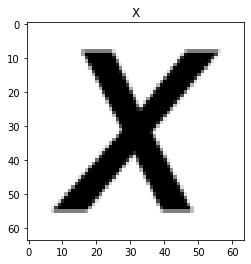

In [14]:
# Proveravamo da li se oznake klasa poklapaju sa slikom
plt.imshow(X[76003])
plt.title(classes[y[76003]])
plt.show()

In [15]:
from sklearn.model_selection import train_test_split

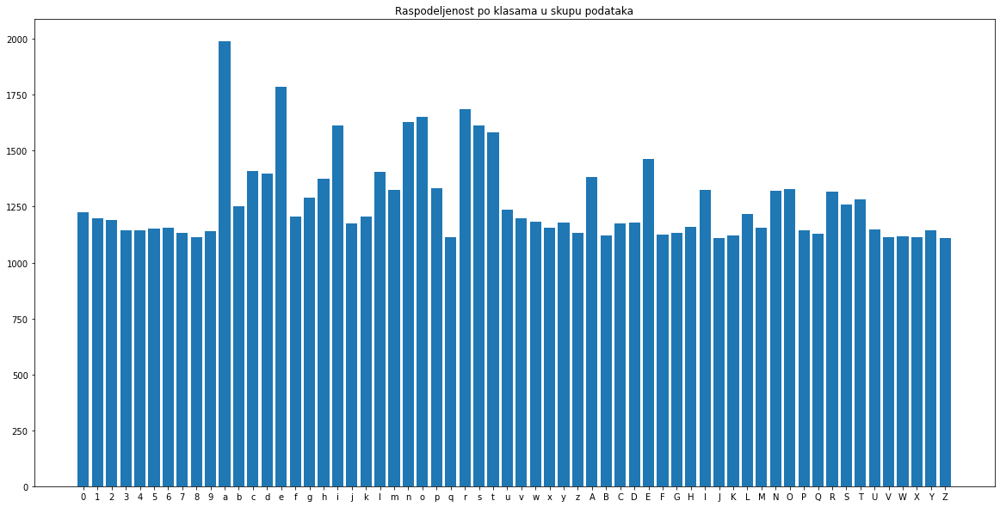

In [16]:
# Gledamo kako su raspoređene instance po klasama u skupu podataka.
# Vidimo da su manje više jednako raspoređene iako nekih ima malo više, ipak ne
# postoji neka klasa koja je jako malo zastupljena, pa ne moramo da vršimo semplovanje
# ili dodavanje posebnih težina.
plt.figure(figsize=(20, 10))
plt.title('Raspodeljenost po klasama u skupu podataka')
plt.bar([classes[el] for el in np.unique(y)], np.bincount(y))
plt.show()

In [18]:
# Delimo podatke na trening i test u odnosu 2:1 i vršimo stratifikaciju po klasama
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, stratify=y)

In [19]:
# Skaliramo vrednosti u pikselima iz celobrojnog opsega [0, 255] na decimalni opseg [0.0, 1.0]
X_train = X_train / 255.0
X_test = X_test / 255.0

In [20]:
np.max(X_train)

1.0

In [21]:
y_train.shape

(52866,)

In [22]:
X_train.shape

(52866, 64, 64, 3)

In [23]:
y_test[0]

9

In [24]:
import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Input, Conv2D, MaxPool2D, Dense, Dropout, Flatten
from keras import utils
from keras.optimizers import Adam

In [26]:
# Pretvaramo oznake klasa iz numeričkih vrednosti u binarne vektore za potrebe treniranja
y_train = utils.to_categorical(y_train, 62)
y_test = utils.to_categorical(y_test, 62)

In [28]:
model = Sequential([
    Conv2D(64, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu', input_shape=(ROWS, COLS, NUM_OF_CHANNELS)),
    Conv2D(32, kernel_size=(3,3), strides=(1,1), padding='same', activation='relu'),
    MaxPool2D(pool_size=(2,2)),
    Dropout(0.2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.2),
    Dense(NUM_OF_CLASSES, activation='softmax')
])

In [29]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 64, 64, 64)        1792      
                                                                 
 conv2d_3 (Conv2D)           (None, 64, 64, 32)        18464     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 32, 32, 32)        0         
 g2D)                                                            
                                                                 
 dropout_2 (Dropout)         (None, 32, 32, 32)        0         
                                                                 
 flatten_1 (Flatten)         (None, 32768)             0         
                                                                 
 dense_1 (Dense)             (None, 128)               4194432   
                                                        

In [30]:
EPOCHS = 20
BATCH_SIZE = 64

In [31]:
model.compile(loss='categorical_crossentropy', optimizer=Adam(0.001), metrics=['accuracy'])

In [32]:
history = model.fit(X_train, y_train, batch_size=BATCH_SIZE, epochs=EPOCHS, validation_split=0.2)

Epoch 1/20
661/661 [==============================] - 221s 332ms/step - loss: 1.7268 - accuracy: 0.5646 - val_loss: 0.9223 - val_accuracy: 0.7472
Epoch 2/20
661/661 [==============================] - 213s 323ms/step - loss: 0.8789 - accuracy: 0.7466 - val_loss: 0.7345 - val_accuracy: 0.7814
Epoch 3/20
661/661 [==============================] - 216s 327ms/step - loss: 0.6679 - accuracy: 0.7930 - val_loss: 0.6812 - val_accuracy: 0.7980
Epoch 4/20
661/661 [==============================] - 219s 332ms/step - loss: 0.5540 - accuracy: 0.8203 - val_loss: 0.6578 - val_accuracy: 0.8100
Epoch 5/20
661/661 [==============================] - 215s 326ms/step - loss: 0.4663 - accuracy: 0.8438 - val_loss: 0.6489 - val_accuracy: 0.8095
Epoch 6/20
661/661 [==============================] - 217s 328ms/step - loss: 0.4015 - accuracy: 0.8628 - val_loss: 0.6666 - val_accuracy: 0.8125
Epoch 7/20
661/661 [==============================] - 215s 326ms/step - loss: 0.3590 - accuracy: 0.8761 - val_loss: 0.6650 -

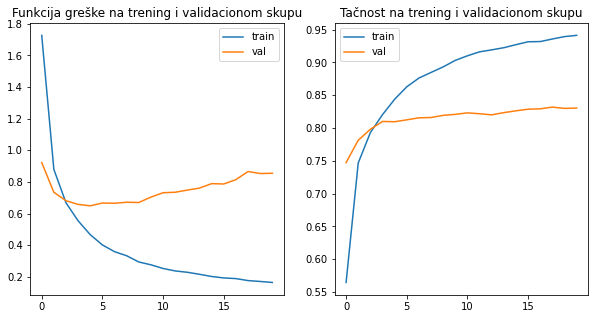

In [37]:
# Posle obučavanja modela prikazujemo funckiju greške i tačnost na trening i validacionom
# skupu kroz epohe.
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.title('Funkcija greške na trening i validacionom skupu')
plt.plot(history.epoch, history.history['loss'], label='train')
plt.plot(history.epoch, history.history['val_loss'], label='val')
plt.legend(loc='best')

plt.subplot(1, 2, 2)
plt.title('Tačnost na trening i validacionom skupu')
plt.plot(history.epoch, history.history['accuracy'], label='train')
plt.plot(history.epoch, history.history['val_accuracy'], label='val')
plt.legend(loc='best')

plt.savefig('architecture1_20epochs_bsize_64.png')

plt.show()

In [36]:
# Evaluiramo model na test podacima
model.evaluate(X_test, y_test)

814/814 [==============================] - 23s 28ms/step - loss: 0.8934 - accuracy: 0.8215


[0.8934304118156433, 0.8215368986129761]

In [38]:
from sklearn.metrics import confusion_matrix, classification_report

In [39]:
# Predviđene vrednosti modela za test podatke
y_pred = model.predict(X_test)

814/814 [==============================] - 23s 28ms/step


In [40]:
# Vraćamo nazad na numeričke vrednosti umesto binarnih vektora
y_pred_numeric = np.argmax(y_pred, axis=1)
y_test_numeric = np.argmax(y_test, axis=1)

In [41]:
# Pišemo izveštaj kalsifikacije da bismo videli neke napredne statistike o klasifikovanju
print(classification_report(y_test_numeric, y_pred_numeric))

              precision    recall  f1-score   support

           0       0.65      0.74      0.69       405
           1       0.85      0.84      0.85       396
           2       0.91      0.94      0.92       392
           3       0.93      0.94      0.94       377
           4       0.91      0.94      0.92       378
           5       0.95      0.94      0.95       380
           6       0.92      0.94      0.93       381
           7       0.95      0.94      0.94       374
           8       0.96      0.93      0.95       367
           9       0.95      0.92      0.93       377
          10       0.83      0.94      0.88       656
          11       0.85      0.89      0.87       412
          12       0.75      0.65      0.70       465
          13       0.88      0.88      0.88       462
          14       0.72      0.92      0.81       589
          15       0.92      0.84      0.88       398
          16       0.87      0.86      0.87       426
          17       0.87    

In [42]:
model.save('architecture1_20epochs_bsize_64')

INFO:tensorflow:Assets written to: architecture1_20epochs_bsize_64\assets


INFO:tensorflow:Assets written to: architecture1_20epochs_bsize_64\assets


In [34]:
loaded_model = keras.models.load_model('models/')

In [35]:
loaded_model.evaluate(X_test, y_test)

814/814 [==============================] - 23s 28ms/step - loss: 0.9335 - accuracy: 0.8202


[0.9334726929664612, 0.8202311992645264]